# **04** Modeling / Feature Selection

In [478]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split

import statsmodels.api as sm
# from statsmodels.tsa.arima_model import ARIMA
# from statsmodels.tsa.vector_ar.vecm import VAR
# from statsmodels.tsa.vector_ar.vecm import coint_johansen
# from statsmodels.tsa.stattools import adfuller
# from statsmodels.tsa.seasonal import seasonal_decompose

# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [479]:
# Import datasets
train = pd.read_csv('./data/model/rtm_train.csv')
unseen = pd.read_csv('./data/model/rtm_test.csv')

# Recreate DateTimeIndex for Training & Unseen Dataset
train.index = pd.to_datetime(train['year-month'])
train = train.drop(columns='year-month')

unseen.index = pd.to_datetime(unseen['year-month'])
unseen = unseen.drop(columns='year-month')

In [480]:
# Which dataset would you like to look at
dataset = train

# Which dataseries in the dataset would you like to look at
dataseries = 'passengers'

# Let's recall the top 10 routes by passengers
dataset.groupby('route')[[dataseries]].mean().sort_values(by=dataseries, ascending=False).head(10)

,passengers
route,
"Dallas, TX - Houston, TX",154019.151515
"Las Vegas, NV - Los Angeles, CA",125936.522727
"Chicago, IL - Los Angeles, CA",122565.931818
"Atlanta, GA - Orlando, FL",108862.287879
"Chicago, IL - New York, NY",107479.704545
"Atlanta, GA - Dallas, TX",100925.030303
"Atlanta, GA - Chicago, IL",99608.877863
"Atlanta, GA - Washington, DC",97533.757576
"Chicago, IL - Minneapolis, MN",97318.734848


# Modeling
- Setting our itinerary to our route we will model 
- Let's look at the numbers from other perspectives
    - Routes that fall into 100 mile increments by distance (i.e. 0-100, 100-200, etc.)
    - Routes by departing airport
    - Routes by Latitude & Longitude

In [481]:
# Let's set the itinerary we will be analyzing
itinerary = 'Atlanta, GA - Columbus, OH'

# Let's look Save a Mask for the dataset for train & unseen datasets
route = train[train['route'] == itinerary].copy()
unseen_route = unseen[unseen['route'] == itinerary].copy()

In [482]:
# Let's look at our possible features
feature_options = sorted(list(train.columns))
feature_options

['airfare',
 'airfare_lag_1',
 'cost_per_mile',
 'dest_lat',
 'dest_long',
 'dist_miles',
 'flight_demand',
 'flight_demand_lag_1',
 'flight_demand_lag_12',
 'flight_revenue',
 'flight_revenue_lag_12',
 'fuel_usd_pergallon',
 'fuel_usd_pergallon_lag_1',
 'num_of_flights',
 'num_of_flights_lag_12',
 'num_of_flights_lag_2',
 'num_of_flights_lag_3',
 'origin_lat',
 'origin_long',
 'passengers',
 'passengers_lag_1',
 'passengers_lag_12',
 'passengers_per_flight',
 'passengers_per_flight_lag_1',
 'passengers_per_flight_lag_12',
 'pop_dest',
 'pop_origin',
 'route',
 'seat_capacity',
 'seat_capacity_lag_1',
 'seat_capacity_lag_2',
 'sf_airfare_diff_1',
 'sf_airfare_lag_1_diff_1',
 'sf_cost_per_mile_diff_1',
 'sf_flight_demand_diff_1',
 'sf_flight_demand_lag_12_diff_1',
 'sf_flight_demand_lag_1_diff_1',
 'sf_flight_revenue_diff_2',
 'sf_flight_revenue_lag_12_diff_1',
 'sf_fuel_usd_pergallon_diff_1',
 'sf_fuel_usd_pergallon_lag_1_diff_1',
 'sf_num_of_flights_diff_1',
 'sf_num_of_flights_lag_12

In [483]:
# We created a lot of features within our 03 jupyter notebook.  let's separate them to ensure we model with correct ones
# Any feature that was differenced was done so for a reason.  Any original column that was differenced should not be used in model.

differenced_features = []
other_features = []
for feature in feature_options:
    if 'diff' in feature:
        differenced_features.append(feature)
    else:
        other_features.append(feature)

In [484]:
other_features # we will only keep # 'dist_miles' as the rest of the features have been differenced or...
               # we won't be using as of now -- but will later, i.e. dest lat, dest long, origin lat, origin long
               # we won't be using any population data as of now or later (dest pop, origin pop)

# save over other features per now....we may come back later and alter       
other_features = ['dist_miles']

# combine features into one list
final_features = differenced_features + other_features
final_features

['sf_airfare_diff_1',
 'sf_airfare_lag_1_diff_1',
 'sf_cost_per_mile_diff_1',
 'sf_flight_demand_diff_1',
 'sf_flight_demand_lag_12_diff_1',
 'sf_flight_demand_lag_1_diff_1',
 'sf_flight_revenue_diff_2',
 'sf_flight_revenue_lag_12_diff_1',
 'sf_fuel_usd_pergallon_diff_1',
 'sf_fuel_usd_pergallon_lag_1_diff_1',
 'sf_num_of_flights_diff_1',
 'sf_num_of_flights_lag_12_diff_1',
 'sf_num_of_flights_lag_2_diff_1',
 'sf_num_of_flights_lag_3_diff_1',
 'sf_passengers_diff_2',
 'sf_passengers_lag_12_diff_2',
 'sf_passengers_lag_1_diff_2',
 'sf_passengers_per_flight_diff_2',
 'sf_passengers_per_flight_lag_12_diff_2',
 'sf_passengers_per_flight_lag_1_diff_1',
 'sf_seat_capacity_diff_1',
 'sf_seat_capacity_lag_1_diff_1',
 'sf_seat_capacity_lag_2_diff_1',
 'sf_total_flight_cost_diff_2',
 'sf_total_flight_miles_diff_1',
 'dist_miles']

In [485]:
# copy & past final features here for easy removal
final_features = [
 'sf_airfare_diff_1',
#  'sf_airfare_lag_1_diff_1',
 'sf_cost_per_mile_diff_1',
#  'sf_flight_demand_diff_1',
#  'sf_flight_demand_lag_12_diff_1',
#  'sf_flight_demand_lag_1_diff_1',
#  'sf_flight_revenue_diff_2',
#  'sf_flight_revenue_lag_12_diff_1',
 'sf_fuel_usd_pergallon_diff_1', ###########
 'sf_fuel_usd_pergallon_lag_1_diff_1', ###########
#  'sf_num_of_flights_diff_1',
#  'sf_num_of_flights_lag_12_diff_1',
 'sf_num_of_flights_lag_2_diff_1',
#  'sf_num_of_flights_lag_3_diff_1',
#  'sf_passengers_diff_2',
#  'sf_passengers_lag_12_diff_2',
 'sf_passengers_lag_1_diff_2',
#  'sf_passengers_per_flight_diff_2',
 'sf_passengers_per_flight_lag_12_diff_2', ###########
#  'sf_passengers_per_flight_lag_1_diff_1',
#  'sf_seat_capacity_diff_1',
#  'sf_seat_capacity_lag_1_diff_1',
#  'sf_seat_capacity_lag_2_diff_1',
#  'sf_total_flight_cost_diff_2',
#  'sf_total_flight_miles_diff_1',
 'dist_miles'
]

# Notice all columns used our DIFF except dist miles which was never differenced

# MAKING NOTE THAT THESE FEATURES ARE GIVING ME NEAR PERFECT RESULTS -- ['sf_airfare_diff_1', 'sf_cost_per_mile_diff_1', 'sf_fuel_usd_pergallon_diff_1', 'sf_fuel_usd_pergallon_lag_1_diff_1', 'sf_num_of_flights_lag_2_diff_1', 'sf_passengers_lag_1_diff_2', 'sf_passengers_per_flight_lag_12_diff_2', 'dist_miles']

### Modeling / Visualization / Analysis Function
- The function below takes in the training dataset & the unseen dataset as well as routes
- It will visualize the results of our model for the test dataset as well as predictions on unseen data
- Additionally it will show us R2, RMSE, and MSE data to compare model/results

In [486]:
def model_func(df_train,
               df_unseen,
               itinerary='Dallas, TX - Houston, TX',
               target_variable_string='airfare', 
               features=['sf_airfare_diff_1', 'sf_cost_per_mile_diff_1', 'sf_fuel_usd_pergallon_diff_1','sf_fuel_usd_pergallon_lag_1_diff_1', 
                         'sf_num_of_flights_lag_2_diff_1', 'sf_passengers_lag_1_diff_2', 'sf_passengers_per_flight_lag_12_diff_2', 'dist_miles'],):

# BOTH    
    # save routes in training & unseen data
    df_train = df_train[df_train['route'] == itinerary].copy()
    df_unseen = df_unseen[df_unseen['route'] == itinerary].copy()

# TRAIN
    # Set X & y variables
    X = df_train[features]
    y = df_train[target_variable_string]
    
    # Train / Test / Split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, shuffle=False)
    
    # Add CONSTANT since we are using statsmodel
    X_train = sm.add_constant(X_train, has_constant='add')
    X_test = sm.add_constant(X_test, has_constant='add')

    # Drop NA values -- statsmodel can't handle
    X_train.dropna(inplace=True)

    # Subset y to match the index from X
    y_train = y_train[X_train.index]

    # Instantiate & fit model
    linear_model = sm.OLS(y_train, X_train).fit()
    
    print(itinerary)
    print()
    print(linear_model.summary())
    
    # Generate predictions
    y_train_pred = linear_model.predict(X_train)
    y_test_pred = linear_model.predict(X_test)

    # Baseline Series
    y_test_baseline = [y_test.mean()] * len(y_test)
    
    # Scoring
    train_r2 = r2_score(y_train, y_train_pred)
    train_rmse = mean_squared_error(y_train, y_train_pred, squared=False)
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    test_rmse = mean_squared_error(y_test, y_test_pred, squared=False)
    test_mse = mean_squared_error(y_test, y_test_pred)
    base_r2 = r2_score(y_test, y_test_baseline)
    base_rmse = mean_squared_error(y_test, y_test_baseline, squared=False)
    base_mse = mean_squared_error(y_test, y_test_baseline)
    

    # Print Scoring
    print('-------------------------')
    print('Train Analytics')
    print('-------------------------')
    print(f'     TRAIN R2: {train_r2}')
    print(f'   TRAIN RMSE: {train_rmse}')
#     print(f'    TRAIN MSE: {train_mse}')
    print('-------------------------')
    print('Test Analytics')
    print('-------------------------')
    print(f'      TEST R2: {test_r2}')
    print(f'    TEST RMSE: {test_rmse}')
#     print(f'     TEST MSE: {test_mse}')
    print('-------------------------')
    print('Baseline Analytics')
    print('-------------------------')
    print(f'  Baseline R2: {base_r2}')
    print(f'Baseline RMSE: {base_rmse}')
#     print(f' Baseline MSE: {base_mse}')
    print()
    
    # Plot Train/Test & Model Predictions on Training Dataset

    # Set figure size.
    plt.figure(figsize=(12, 4))
    plt.grid()
    
    # Plot training data.
    plt.plot(y_train.index, y_train.values, color = 'blue', label='Training Values')
    # Plot testing data.
    plt.plot(y_test.index, y_test.values, color = 'orange', label='Test Values', linewidth=10)
    # Plot predicted test values.
    plt.plot(y_test_pred, color = 'green', label='Predicted Test Values')

    # Set label.
    plt.title(label = 'Train / Test + Predictions: ' + str(itinerary), fontsize=20)
    # Resize tick marks.
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12);
    # Label Axis
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)
    plt.xlabel('Year-Month', size=12)
    # add legend
    plt.legend();

# UNSEEN

    # Create X variable for our unseen dataset with the matching itinerary of our model
    X_unseen = df_unseen[features]

    # Add X Constant
    X_unseen = sm.add_constant(X_unseen, has_constant='add')

    # Make Predictions -- In this case we are predicting airfare price
    unseen_pred = linear_model.predict(X_unseen)

    # save predictions to unseen route df
    df_unseen['airfare_predictions'] = unseen_pred

    # dropna values for scoring
    df_unseen = df_unseen.dropna()
    
    # score
    unseen_r2 = r2_score(df_unseen.airfare, df_unseen.airfare_predictions)
    unseen_rmse = mean_squared_error(df_unseen.airfare, df_unseen.airfare_predictions, squared=False)
    unseen_mse = mean_squared_error(df_unseen.airfare, df_unseen.airfare_predictions, squared=True)
    
    # print score
    print('-------------------------------------------')
    print('Analytics for Predictions on unseen Data')
    print('-------------------------------------------')
    print(f'      PRED R2: {unseen_r2}')
    print(f'    PRED RMSE: {unseen_rmse}')
#     print(f'     PRED MSE: {unseen_mse}')

    # Let's plot our predictions! 

    # Set figure size.
    plt.figure(figsize=(12, 4))
    plt.grid()

    # Plot actual data.
    plt.plot(df_unseen['airfare'], color = 'orange', label='Actual Airfare Price', linewidth=10)

    # Plot predicted test values.
    plt.plot(df_unseen['airfare_predictions'], color = 'green', label='Predicted Airfare Price')

    # Set label.
    plt.title(label = 'Predictions (unseen data): ' + str(itinerary), fontsize=20)

    # Resize tick marks.
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12);

    # Label Axis
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)
    plt.xlabel('Year-Month', size=12)

    # add legend
    plt.legend();
    
    # create datafram with the analytics for the route
    results_df = pd.DataFrame(data=[[itinerary, base_r2, train_r2, test_r2, unseen_r2, base_rmse, train_rmse, test_rmse, unseen_rmse]],
                              columns=['route', 'base_r2', 'train_r2', 'test_r2', 'unseen_r2', 'base_rmse', 'train_rmse', 'test_rmse', 'unseen_rmse'])
    
    # linear_model returns the model object, results_df returns the invidual route analytics
    return linear_model, results_df 

Dallas, TX - Houston, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.471e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          8.28e-203
Time:                        17:27:28   Log-Likelihood:                 222.24
No. Observations:                  92   AIC:                            -430.5
Df Residuals:                      85   BIC:                            -412.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

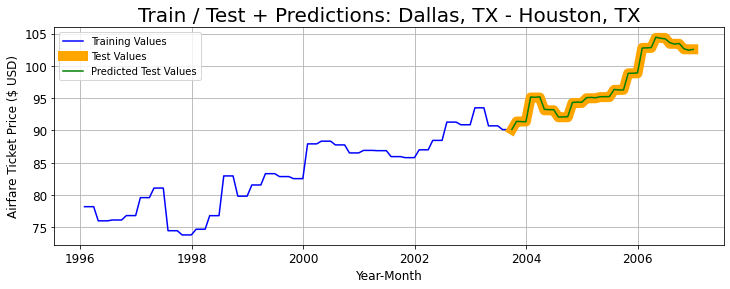

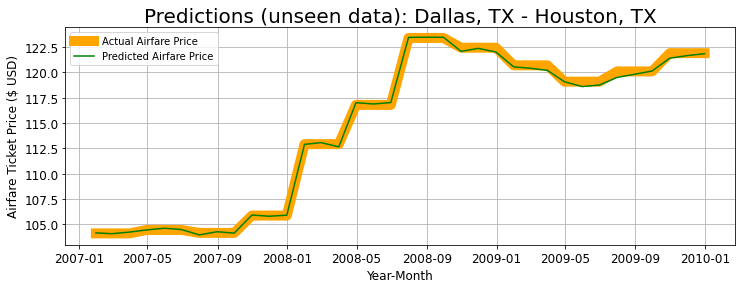

In [487]:
# Testing Function on One Route
result, new_df = model_func(train, unseen)

# Testing On All Routes

Atlanta, GA - Columbus, OH

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.580e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.14e-188
Time:                        17:27:29   Log-Likelihood:                -9.4144
No. Observations:                  92   AIC:                             30.83
Df Residuals:                      86   BIC:                             45.96
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.333288960182878e-10
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9984219379142275
    TEST RMSE: 0.379635721569437
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 9.556635623350928

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9977084663534492
    PRED RMSE: 0.3843817410102268
Atlanta, GA - Minneapolis, MN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.897e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
T

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Atlanta, GA - New Orleans, LA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.009e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:30   Log-Likelihood:                 2073.1
No. Observations:                  92   AIC:                            -4134.
Df Residuals:                      86   BIC:                            -4119.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Atlanta, GA - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.380e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          8.16e-220
Time:                        17:27:30   Log-Likelihood:                 168.56
No. Observations:                  92   AIC:                            -323.1
Df Residuals:                      85   BIC:                            -305.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.7688492341310503e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 1.0
    TEST RMSE: 3.866756777121825e-11
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.572757182091955

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 3.4695597340005125e-11
Atlanta, GA - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.136e+25
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:          

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.177e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:31   Log-Likelihood:                 1994.6
No. Observations:                  92   AIC:                            -3977.
Df Residuals:                      86   BIC:                            -3962.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Atlanta, GA - Richmond, VA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.734e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:31   Log-Likelihood:                 1977.7
No. Observations:                  92   AIC:                            -3943.
Df Residuals:                      86   BIC:                            -3928.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Atlanta, GA - San Antonio, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.287e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:31   Log-Likelihood:                 2011.6
No. Observations:                  92   AIC:                            -4009.
Df Residuals:                      85   BIC:                            -3991.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Atlanta, GA - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.766e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          4.34e-265
Time:                        17:27:32   Log-Likelihood:                 198.19
No. Observations:                  92   AIC:                            -382.4
Df Residuals:                      85   BIC:                            -364.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Atlanta, GA - Tampa, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.641e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.61e-126
Time:                        17:27:32   Log-Likelihood:                -61.626
No. Observations:                  92   AIC:                             135.3
Df Residuals:                      86   BIC:                             150.4
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9995934342583002
    PRED RMSE: 0.25077969458192884
Austin, TX - Chicago, IL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.992e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.51e-131
Time:                        17:27:32   Log-Likelihood:                -107.61
No. Observations:                  92   AIC:                             229.2
Df Residuals:                      85   BIC:                             246.9
Df Model:                           6                                         
Covariance Type:            nonrobust                            

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9999900148033192
   TRAIN RMSE: 0.025295357134213495
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9899919110280018
    TEST RMSE: 0.38543179780473286
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.85276004962676

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9821282234861664
    PRED RMSE: 1.1182936007229036
Austin, TX - El Paso, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.493e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):     

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9711338976551918
    PRED RMSE: 1.3551847321507196
Austin, TX - Houston, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.834e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.25e-161
Time:                        17:27:33   Log-Likelihood:                 84.399
No. Observations:                  92   AIC:                            -154.8
Df Residuals:                      85   BIC:                            -137.1
Df Model:                           6                                         
Covariance Type:            nonrobust                             

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Austin, TX - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     7256.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.26e-113
Time:                        17:27:35   Log-Likelihood:                -73.971
No. Observations:                  92   AIC:                             161.9
Df Residuals:                      85   BIC:                             179.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Chicago, IL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.112e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          9.11e-225
Time:                        17:27:35   Log-Likelihood:                 133.70
No. Observations:                  92   AIC:                            -253.4
Df Residuals:                      85   BIC:                            -235.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Cleveland, OH

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.252e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:36   Log-Likelihood:                 1894.6
No. Observations:                  92   AIC:                            -3777.
Df Residuals:                      86   BIC:                            -3762.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Detroit, MI

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.503e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.82e-254
Time:                        17:27:36   Log-Likelihood:                 164.42
No. Observations:                  92   AIC:                            -314.8
Df Residuals:                      85   BIC:                            -297.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.072e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.42e-174
Time:                        17:27:36   Log-Likelihood:                -8.3357
No. Observations:                  92   AIC:                             28.67
Df Residuals:                      86   BIC:                             43.80
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Milwaukee, WI

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.501e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:36   Log-Likelihood:                 1798.2
No. Observations:                  92   AIC:                            -3584.
Df Residuals:                      86   BIC:                            -3569.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.135e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.21e-248
Time:                        17:27:37   Log-Likelihood:                 300.61
No. Observations:                  92   AIC:                            -587.2
Df Residuals:                      85   BIC:                            -569.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Philadelphia, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.020e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.20e-282
Time:                        17:27:37   Log-Likelihood:                 252.08
No. Observations:                  92   AIC:                            -492.2
Df Residuals:                      86   BIC:                            -477.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Boston, MA - Raleigh, NC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.020e+25
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:37   Log-Likelihood:                 2108.2
No. Observations:                  92   AIC:                            -4204.
Df Residuals:                      86   BIC:                            -4189.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.738e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:37   Log-Likelihood:                 1917.1
No. Observations:                  92   AIC:                            -3822.
Df Residuals:                      86   BIC:                            -3807.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Boston, MA - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.481e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:37   Log-Likelihood:                 1890.3
No. Observations:                  92   AIC:                            -3769.
Df Residuals:                      86   BIC:                            -3753.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Boston, MA - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.583e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.73e-212
Time:                        17:27:38   Log-Likelihood:                 149.35
No. Observations:                  92   AIC:                            -284.7
Df Residuals:                      85   BIC:                            -267.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Buffalo, NY - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.492e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.07e-168
Time:                        17:27:38   Log-Likelihood:                 5.9270
No. Observations:                  92   AIC:                             2.146
Df Residuals:                      85   BIC:                             19.80
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Charlotte, NC - Dallas, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.356e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.34e-158
Time:                        17:27:38   Log-Likelihood:                -62.068
No. Observations:                  92   AIC:                             138.1
Df Residuals:                      85   BIC:                             155.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.997058860979042
    PRED RMSE: 0.43156977791745776
Charlotte, NC - Houston, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.954e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.13e-173
Time:                        17:27:38   Log-Likelihood:               -0.80495
No. Observations:                  92   AIC:                             15.61
Df Residuals:                      85   BIC:                             33.26
Df Model:                           6                                         
Covariance Type:            nonrobust                          

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9998907578284072
    PRED RMSE: 0.20629952200960344
Charlotte, NC - Miami, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.533e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.35e-254
Time:                        17:27:39   Log-Likelihood:                 255.61
No. Observations:                  92   AIC:                            -497.2
Df Residuals:                      85   BIC:                            -479.6
Df Model:                           6                                         
Covariance Type:            nonrobust                           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Charlotte, NC - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.843e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.53e-286
Time:                        17:27:39   Log-Likelihood:                 324.53
No. Observations:                  92   AIC:                            -635.1
Df Residuals:                      85   BIC:                            -617.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.574
Model:                            OLS   Adj. R-squared:                  0.544
Method:                 Least Squares   F-statistic:                     19.11
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           5.72e-14
Time:                        17:27:39   Log-Likelihood:                -370.95
No. Observations:                  92   AIC:                             755.9
Df Residuals:                      85   BIC:                             773.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.614e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:40   Log-Likelihood:                 2062.9
No. Observations:                  92   AIC:                            -4114.
Df Residuals:                      86   BIC:                            -4099.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9968677421774708
   TRAIN RMSE: 2.3965389686494722
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9950716883473465
    TEST RMSE: 3.0567139401982755
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 43.54173354309059

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.996632455393814
    PRED RMSE: 3.078593639469164
Chicago, IL - Cleveland, OH

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.853
Method:                 Least Squares   F-statistic:                     89.11
Date:                Tue, 06 Oct 2020   Prob (F-statistic):     

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9623679128201579
   TRAIN RMSE: 1.7036425274781672
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.841919929657014
    TEST RMSE: 2.5219671361528855
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.3430898424979

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: -0.16967480313688532
    PRED RMSE: 4.619648489028897
Chicago, IL - Dallas, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.858e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Detroit, MI

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.505e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.83e-184
Time:                        17:27:40   Log-Likelihood:                 163.38
No. Observations:                  92   AIC:                            -312.8
Df Residuals:                      85   BIC:                            -295.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9991293622123223
   TRAIN RMSE: 0.4150758707861249
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9973403648376689
    TEST RMSE: 0.4091275248885767
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.933186524814604

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9936949153499586
    PRED RMSE: 0.8254318831691945
Chicago, IL - Indianapolis, IN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.978e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic): 

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9732045755080079
   TRAIN RMSE: 0.8978769849900534
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.8540140406077876
    TEST RMSE: 2.5392598439127805
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.645866309218086

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.8168847793153993
    PRED RMSE: 2.7312642348875085
Chicago, IL - Las Vegas, NV

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.949e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):   

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Chicago, IL - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.045e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.62e-174
Time:                        17:27:41   Log-Likelihood:                -11.410
No. Observations:                  92   AIC:                             36.82
Df Residuals:                      85   BIC:                             54.47
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Miami, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.740e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.89e-159
Time:                        17:27:41   Log-Likelihood:                 14.930
No. Observations:                  92   AIC:                            -15.86
Df Residuals:                      85   BIC:                             1.793
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9373053935911586
   TRAIN RMSE: 1.6813366160576855
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9004781292484674
    TEST RMSE: 1.5593016659981094
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 4.94277540962565

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.5601294166630741
    PRED RMSE: 2.532322384551359


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - New Orleans, LA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     5396.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.78e-107
Time:                        17:27:42   Log-Likelihood:                -98.970
No. Observations:                  92   AIC:                             211.9
Df Residuals:                      85   BIC:                             229.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Oklahoma City, OK

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.909
Model:                            OLS   Adj. R-squared:                  0.902
Method:                 Least Squares   F-statistic:                     141.1
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           5.21e-42
Time:                        17:27:42   Log-Likelihood:                -253.80
No. Observations:                  92   AIC:                             521.6
Df Residuals:                      85   BIC:                             539.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.310e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.56e-155
Time:                        17:27:42   Log-Likelihood:                 12.695
No. Observations:                  92   AIC:                            -11.39
Df Residuals:                      85   BIC:                             6.263
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.359e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.83e-153
Time:                        17:27:43   Log-Likelihood:                -21.912
No. Observations:                  92   AIC:                             57.82
Df Residuals:                      85   BIC:                             75.48
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Portland, OR

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.395e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.87e-167
Time:                        17:27:43   Log-Likelihood:                -8.5433
No. Observations:                  92   AIC:                             31.09
Df Residuals:                      85   BIC:                             48.74
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Chicago, IL - Richmond, VA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.760
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     44.82
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           2.65e-24
Time:                        17:27:43   Log-Likelihood:                -391.75
No. Observations:                  92   AIC:                             797.5
Df Residuals:                      85   BIC:                             815.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9985055995148385
    PRED RMSE: 0.5835038214357242
Chicago, IL - Salt Lake City, UT

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.896e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.25e-190
Time:                        17:27:43   Log-Likelihood:                 85.455
No. Observations:                  92   AIC:                            -156.9
Df Residuals:                      85   BIC:                            -139.3
Df Model:                           6                                         
Covariance Type:            nonrobust                     

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9856579900499916
    PRED RMSE: 0.9219770102505452
Chicago, IL - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.317e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.25e-245
Time:                        17:27:44   Log-Likelihood:                 115.55
No. Observations:                  92   AIC:                            -217.1
Df Residuals:                      85   BIC:                            -199.4
Df Model:                           6                                         
Covariance Type:            nonrobust                      

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Chicago, IL - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.188e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.39e-207
Time:                        17:27:44   Log-Likelihood:                 220.28
No. Observations:                  92   AIC:                            -426.6
Df Residuals:                      85   BIC:                            -408.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Chicago, IL - Tucson, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 2.186e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.92e-133
Time:                        17:27:44   Log-Likelihood:                -81.699
No. Observations:                  92   AIC:                             177.4
Df Residuals:                      85   BIC:                             195.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.7153167492432305e-10
-------------------------
Test Analytics
-------------------------
      TEST R2: 1.0
    TEST RMSE: 4.1132587111305767e-10
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.67562385347882

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999903361213882
    PRED RMSE: 0.09479541353764868
Cincinnati, OH - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.956e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.41e-229
Time:                       

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9993367932417222
    PRED RMSE: 0.8586067268473729
Cincinnati, OH - Philadelphia, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.985
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                     1168.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.98e-77
Time:                        17:27:45   Log-Likelihood:                -184.36
No. Observations:                  92   AIC:                             380.7
Df Residuals:                      86   BIC:                             395.9
Df Model:                           5                                         
Covariance Type:            nonrobust                    

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Cincinnati, OH - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.505e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:45   Log-Likelihood:                 1916.5
No. Observations:                  92   AIC:                            -3821.
Df Residuals:                      86   BIC:                            -3806.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9997987545125343
   TRAIN RMSE: 0.24511858920914248
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9998855031755886
    TEST RMSE: 0.4523141692356494
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 42.27109245616324

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.999649464058384
    PRED RMSE: 0.9579772866479985
Cleveland, OH - Dallas, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.975
Model:                            OLS   Adj. R-squared:                  0.973
Method:                 Least Squares   F-statistic:                     553.1
Date:                Tue, 06 Oct 2020   Prob (F-statistic):    

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.972
Model:                            OLS   Adj. R-squared:                  0.970
Method:                 Least Squares   F-statistic:                     493.8
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           7.84e-64
Time:                        17:27:46   Log-Likelihood:                -230.23
No. Observations:                  92   AIC:                             474.5
Df Residuals:                      85   BIC:                             492.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.999644489714382
    PRED RMSE: 0.29182040343975757
Cleveland, OH - Miami, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.585e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:46   Log-Likelihood:                 1959.2
No. Observations:                  92   AIC:                            -3906.
Df Residuals:                      86   BIC:                            -3891.
Df Model:                           5                                         
Covariance Type:            nonrobust                            

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Cleveland, OH - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.400e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.72e-220
Time:                        17:27:46   Log-Likelihood:                 139.79
No. Observations:                  92   AIC:                            -265.6
Df Residuals:                      85   BIC:                            -247.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Cleveland, OH - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.293e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:46   Log-Likelihood:                 1874.6
No. Observations:                  92   AIC:                            -3737.
Df Residuals:                      86   BIC:                            -3722.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Cleveland, OH - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.736e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          8.04e-159
Time:                        17:27:47   Log-Likelihood:                 53.821
No. Observations:                  92   AIC:                            -93.64
Df Residuals:                      85   BIC:                            -75.99
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Columbus, OH - Dallas, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.976e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.24e-191
Time:                        17:27:47   Log-Likelihood:                -1.9363
No. Observations:                  92   AIC:                             17.87
Df Residuals:                      85   BIC:                             35.53
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.999654719200811
   TRAIN RMSE: 0.5638259756363483
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.999014618669073
    TEST RMSE: 1.006428178927545
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 32.061262739285546

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9991949058526658
    PRED RMSE: 0.9874445117332918
Columbus, OH - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.984
Model:                            OLS   Adj. R-squared:                  0.983
Method:                 Least Squares   F-statistic:                     880.8
Date:                Tue, 06 Oct 2020   Prob (F-statistic):      

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9980585903441495
   TRAIN RMSE: 1.0943886824627096
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9750118036228193
    TEST RMSE: 2.0609635840132423
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.037756418859036

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.8341435517710312
    PRED RMSE: 4.026644861501556
Dallas, TX - Detroit, MI

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.987
Model:                            OLS   Adj. R-squared:                  0.986
Method:                 Least Squares   F-statistic:                     1087.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):      

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


Train Analytics
-------------------------
     TRAIN R2: 0.9977400697032419
   TRAIN RMSE: 0.46107390639692336
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9839464519185551
    TEST RMSE: 0.5740286815454352
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 4.530520251582592

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9988138619635004
    PRED RMSE: 0.39997897626736023
Dallas, TX - Hartford, CT

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.794e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.998992723971224
    PRED RMSE: 0.23962518855299444
Dallas, TX - Indianapolis, IN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.301e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          9.57e-146
Time:                        17:27:48   Log-Likelihood:                -73.244
No. Observations:                  92   AIC:                             160.5
Df Residuals:                      85   BIC:                             178.1
Df Model:                           6                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Dallas, TX - Jacksonville, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     6722.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.95e-110
Time:                        17:27:48   Log-Likelihood:                -127.16
No. Observations:                  92   AIC:                             266.3
Df Residuals:                      86   BIC:                             281.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Dallas, TX - Las Vegas, NV

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.815e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.54e-190
Time:                        17:27:48   Log-Likelihood:                 47.902
No. Observations:                  92   AIC:                            -81.80
Df Residuals:                      85   BIC:                            -64.15
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Dallas, TX - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.735e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          4.51e-199
Time:                        17:27:49   Log-Likelihood:                 81.368
No. Observations:                  92   AIC:                            -148.7
Df Residuals:                      85   BIC:                            -131.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     6574.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          4.12e-111
Time:                        17:27:49   Log-Likelihood:                -111.59
No. Observations:                  92   AIC:                             237.2
Df Residuals:                      85   BIC:                             254.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9998910313978131
   TRAIN RMSE: 0.23115281859979364
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9952227463549103
    TEST RMSE: 1.1547652414611813
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.70723390480902

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9930495380195712
    PRED RMSE: 1.149699839345659
Dallas, TX - Minneapolis, MN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.868
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                     92.98
Date:                Tue, 06 Oct 2020   Prob (F-statistic):  

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Dallas, TX - Nashville, TN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.529e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.19e-211
Time:                        17:27:49   Log-Likelihood:                 149.69
No. Observations:                  92   AIC:                            -285.4
Df Residuals:                      85   BIC:                            -267.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9360300610538266
    PRED RMSE: 1.175129874672068
Dallas, TX - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.729e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.02e-171
Time:                        17:27:50   Log-Likelihood:                -9.3059
No. Observations:                  92   AIC:                             32.61
Df Residuals:                      85   BIC:                             50.26
Df Model:                           6                                         
Covariance Type:            nonrobust                             

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9996261547073264
    PRED RMSE: 0.307785080378608
Dallas, TX - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.411e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.32e-280
Time:                        17:27:50   Log-Likelihood:                 325.07
No. Observations:                  92   AIC:                            -636.1
Df Residuals:                      85   BIC:                            -618.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                               

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9971616487777109
    PRED RMSE: 0.6696603085385784
Dallas, TX - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.093e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.90e-217
Time:                        17:27:50   Log-Likelihood:                 119.29
No. Observations:                  92   AIC:                            -224.6
Df Residuals:                      85   BIC:                            -206.9
Df Model:                           6                                         
Covariance Type:            nonrobust                             

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Dallas, TX - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.270e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.71e-149
Time:                        17:27:50   Log-Likelihood:                -103.69
No. Observations:                  92   AIC:                             221.4
Df Residuals:                      85   BIC:                             239.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Dallas, TX - Raleigh, NC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.604e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.57e-212
Time:                        17:27:51   Log-Likelihood:                 94.301
No. Observations:                  92   AIC:                            -174.6
Df Residuals:                      85   BIC:                            -156.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.784e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.09e-241
Time:                        17:27:51   Log-Likelihood:                 117.21
No. Observations:                  92   AIC:                            -220.4
Df Residuals:                      85   BIC:                            -202.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Dallas, TX - San Antonio, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.920e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.37e-223
Time:                        17:27:51   Log-Likelihood:                 273.54
No. Observations:                  92   AIC:                            -533.1
Df Residuals:                      85   BIC:                            -515.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Dallas, TX - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.400e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.94e-192
Time:                        17:27:52   Log-Likelihood:                 31.692
No. Observations:                  92   AIC:                            -49.38
Df Residuals:                      85   BIC:                            -31.73
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9930983498757866
   TRAIN RMSE: 1.596583653354164
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9945849649896099
    TEST RMSE: 1.61400128773276
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.933262808745535

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9889550806471886
    PRED RMSE: 1.64735951821041
Dallas, TX - Tucson, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     9031.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9993740108656181
   TRAIN RMSE: 0.0971585363519986
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9947473902698161
    TEST RMSE: 0.3098673323318681
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.275512951681937

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9980396422743673
    PRED RMSE: 0.2724319861102222
Dallas, TX - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.141e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):   

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Detroit, MI - Hartford, CT

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.227e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.89e-160
Time:                        17:27:52   Log-Likelihood:                -22.129
No. Observations:                  92   AIC:                             58.26
Df Residuals:                      85   BIC:                             75.91
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Detroit, MI - Kansas City, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.635e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.62e-128
Time:                        17:27:52   Log-Likelihood:                -62.369
No. Observations:                  92   AIC:                             138.7
Df Residuals:                      85   BIC:                             156.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Detroit, MI - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.751e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          4.23e-236
Time:                        17:27:53   Log-Likelihood:                 137.54
No. Observations:                  92   AIC:                            -261.1
Df Residuals:                      85   BIC:                            -243.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Detroit, MI - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 2.909e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.57e-138
Time:                        17:27:53   Log-Likelihood:                -104.55
No. Observations:                  92   AIC:                             223.1
Df Residuals:                      85   BIC:                             240.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9983459959713504
   TRAIN RMSE: 0.5889703213110846
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9989759199112088
    TEST RMSE: 0.5566989893415715
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 17.396163138390605

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9901616849444979
    PRED RMSE: 0.9493550908132635
Detroit, MI - Philadelphia, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.063e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic)

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9995226131292816
   TRAIN RMSE: 0.2693834825179236
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9992757608950178
    TEST RMSE: 0.3227625597156541
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.993395784243093

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9992939041431993
    PRED RMSE: 0.30215671547380996
Detroit, MI - Raleigh, NC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.228e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):   

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9999583131339351
   TRAIN RMSE: 0.2538427384024774
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9987270643285298
    TEST RMSE: 0.40096813963087463
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.23845567682678

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9995747285389058
    PRED RMSE: 0.3405029691683369
Detroit, MI - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.474e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):     

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


Train Analytics
-------------------------
     TRAIN R2: 0.9999910274581468
   TRAIN RMSE: 0.023106898482630756
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9997660170928258
    TEST RMSE: 0.08359431138027984
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.464930689176212

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9996818815952758
    PRED RMSE: 0.08777960840843534
Detroit, MI - Tampa, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 2.662e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.82e-137
Time:    

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9963043239264356
    PRED RMSE: 0.9101205037327408
El Paso, TX - Houston, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.986
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                     1019.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           6.27e-77
Time:                        17:27:54   Log-Likelihood:                -188.59
No. Observations:                  92   AIC:                             391.2
Df Residuals:                      85   BIC:                             408.8
Df Model:                           6                                         
Covariance Type:            nonrobust                            

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.3946793462381195e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9996889733686811
    TEST RMSE: 0.05690611434194346
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.2267115516420124

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9985566884820423
    PRED RMSE: 0.3162562049379226
El Paso, TX - San Antonio, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.567e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.27e-157
Time:           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 3.1712111255144e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9999999328083795
    TEST RMSE: 0.011413192877631085
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 44.0300926292178

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999998853000598
    PRED RMSE: 0.014763912014643665
Hartford, CT - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.387
Model:                            OLS   Adj. R-squared:                  0.359
Method:                 Least Squares   F-statistic:                     13.72
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.03

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Hartford, CT - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.988e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.38e-174
Time:                        17:27:55   Log-Likelihood:                 21.777
No. Observations:                  92   AIC:                            -29.55
Df Residuals:                      85   BIC:                            -11.90
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Kansas City, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     4973.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.68e-106
Time:                        17:27:55   Log-Likelihood:                -95.320
No. Observations:                  92   AIC:                             204.6
Df Residuals:                      85   BIC:                             222.3
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.993
Model:                            OLS   Adj. R-squared:                  0.993
Method:                 Least Squares   F-statistic:                     2033.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.52e-89
Time:                        17:27:56   Log-Likelihood:                -153.72
No. Observations:                  92   AIC:                             321.4
Df Residuals:                      85   BIC:                             339.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Minneapolis, MN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     7929.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.45e-114
Time:                        17:27:56   Log-Likelihood:                -124.26
No. Observations:                  92   AIC:                             262.5
Df Residuals:                      85   BIC:                             280.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - New Orleans, LA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.573e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.53e-142
Time:                        17:27:56   Log-Likelihood:                 39.819
No. Observations:                  92   AIC:                            -65.64
Df Residuals:                      85   BIC:                            -47.99
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Oklahoma City, OK

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.587e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.43e-150
Time:                        17:27:56   Log-Likelihood:                 54.751
No. Observations:                  92   AIC:                            -95.50
Df Residuals:                      85   BIC:                            -77.85
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Philadelphia, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.265e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.11e-176
Time:                        17:27:57   Log-Likelihood:                -31.368
No. Observations:                  92   AIC:                             76.74
Df Residuals:                      85   BIC:                             94.39
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 2.670e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.97e-137
Time:                        17:27:57   Log-Likelihood:                -135.66
No. Observations:                  92   AIC:                             285.3
Df Residuals:                      85   BIC:                             303.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - San Antonio, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.308e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.14e-183
Time:                        17:27:57   Log-Likelihood:                 167.03
No. Observations:                  92   AIC:                            -320.1
Df Residuals:                      85   BIC:                            -302.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Houston, TX - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.560e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.46e-211
Time:                        17:27:57   Log-Likelihood:                 96.805
No. Observations:                  92   AIC:                            -181.6
Df Residuals:                      86   BIC:                            -166.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Houston, TX - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.454e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.01e-210
Time:                        17:27:57   Log-Likelihood:                 162.36
No. Observations:                  92   AIC:                            -310.7
Df Residuals:                      85   BIC:                            -293.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9995175432990435
   TRAIN RMSE: 0.1758865635670845
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9976571547415996
    TEST RMSE: 0.3219716757611592
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.651902354777918

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9924201571322963
    PRED RMSE: 1.0925444997810863
Houston, TX - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     6218.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):  

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.953
Model:                            OLS   Adj. R-squared:                  0.951
Method:                 Least Squares   F-statistic:                     350.9
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.27e-55
Time:                        17:27:58   Log-Likelihood:                -167.26
No. Observations:                  92   AIC:                             346.5
Df Residuals:                      86   BIC:                             361.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.4232718005815294e-09
Indianapolis, IN - Minneapolis, MN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.176e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:59   Log-Likelihood:                 2049.1
No. Observations:                  92   AIC:                            -4086.
Df Residuals:                      86   BIC:                            -4071.
Df Model:                           5                                         
Covariance Type:            nonrobust                              

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Indianapolis, IN - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.980
Model:                            OLS   Adj. R-squared:                  0.978
Method:                 Least Squares   F-statistic:                     683.0
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.14e-69
Time:                        17:27:59   Log-Likelihood:                -143.00
No. Observations:                  92   AIC:                             300.0
Df Residuals:                      85   BIC:                             317.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Indianapolis, IN - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.261e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:27:59   Log-Likelihood:                 2043.7
No. Observations:                  92   AIC:                            -4075.
Df Residuals:                      86   BIC:                            -4060.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Jacksonville, FL - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.992
Model:                            OLS   Adj. R-squared:                  0.992
Method:                 Least Squares   F-statistic:                     1793.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           3.08e-87
Time:                        17:27:59   Log-Likelihood:                -209.76
No. Observations:                  92   AIC:                             433.5
Df Residuals:                      85   BIC:                             451.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9999997855390438
   TRAIN RMSE: 0.0087690358287321
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.999726045214787
    TEST RMSE: 0.10126124743431071
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.117920480032411

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9990027482141102
    PRED RMSE: 0.26047273293026174
Kansas City, MO - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.473e+05
Date:                Tue, 06 Oct 2020   Prob (F-statist

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9999978414631135
   TRAIN RMSE: 0.09411723524246354
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9999557540029869
    TEST RMSE: 0.1362758814010864
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.487171679797576

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.999904205458075
    PRED RMSE: 0.38419420233025237
Kansas City, MO - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.469e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Train Analytics
-------------------------
     TRAIN R2: 0.985279407204541
   TRAIN RMSE: 2.1578741666093006
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9686538221431461
    TEST RMSE: 2.581600888216689
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.581318793236775

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9008606798085272
    PRED RMSE: 4.855531361092018
Kansas City, MO - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.996
Model:                            OLS   Adj. R-squared:                  0.996
Method:                 Least Squares   F-statistic:                     3529.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.15e-99
Time: 

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Las Vegas, NV - Los Angeles, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     9932.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.69e-117
Time:                        17:28:00   Log-Likelihood:                 18.946
No. Observations:                  92   AIC:                            -25.89
Df Residuals:                      86   BIC:                            -10.76
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Las Vegas, NV - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.752e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.70e-307
Time:                        17:28:01   Log-Likelihood:                 374.03
No. Observations:                  92   AIC:                            -734.1
Df Residuals:                      85   BIC:                            -716.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Las Vegas, NV - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.028e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:01   Log-Likelihood:                 2057.2
No. Observations:                  92   AIC:                            -4102.
Df Residuals:                      86   BIC:                            -4087.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 4.155247695713338e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 1.0
    TEST RMSE: 4.188077295863047e-11
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 9.170159073729312

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9998270816861524
    PRED RMSE: 0.0827584871031964
Las Vegas, NV - Reno, NV

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.037e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:            

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 3.215652703353037e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9999607689384054
    TEST RMSE: 0.07613285457431083
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.155059347860051

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999526534659275
    PRED RMSE: 0.0666552815153963
Las Vegas, NV - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.470e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):       

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9999999993710511
   TRAIN RMSE: 0.00032261698445532603
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9999998796017769
    TEST RMSE: 0.003505552616226869
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.102909234473008

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999993405956078
    PRED RMSE: 0.006487139087736587
Las Vegas, NV - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.349e+06
Date:                Tue, 06 Oct 2020   Prob (F-sta

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Las Vegas, NV - Tucson, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.730e+10
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:02   Log-Likelihood:                 736.45
No. Observations:                  92   AIC:                            -1459.
Df Residuals:                      85   BIC:                            -1441.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - Miami, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.291e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:02   Log-Likelihood:                 1803.0
No. Observations:                  92   AIC:                            -3594.
Df Residuals:                      86   BIC:                            -3579.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - Nashville, TN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.969e+19
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:02   Log-Likelihood:                 1587.2
No. Observations:                  92   AIC:                            -3162.
Df Residuals:                      86   BIC:                            -3147.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.647e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.08e-189
Time:                        17:28:03   Log-Likelihood:                 75.648
No. Observations:                  92   AIC:                            -139.3
Df Residuals:                      86   BIC:                            -124.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.296e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:03   Log-Likelihood:                 2027.5
No. Observations:                  92   AIC:                            -4043.
Df Residuals:                      86   BIC:                            -4028.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w



                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.373e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:03   Log-Likelihood:                 2058.5
No. Observations:                  92   AIC:                            -4105.
Df Residuals:                      86   BIC:                            -4090.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Los Angeles, CA - Sacramento, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.825e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.28e-130
Time:                        17:28:03   Log-Likelihood:                 61.460
No. Observations:                  92   AIC:                            -108.9
Df Residuals:                      85   BIC:                            -91.27
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.001e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:04   Log-Likelihood:                 2015.7
No. Observations:                  92   AIC:                            -4019.
Df Residuals:                      86   BIC:                            -4004.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Los Angeles, CA - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.256e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.94e-219
Time:                        17:28:04   Log-Likelihood:                 143.52
No. Observations:                  92   AIC:                            -273.0
Df Residuals:                      85   BIC:                            -255.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Los Angeles, CA - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.455e+09
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:04   Log-Likelihood:                 442.11
No. Observations:                  92   AIC:                            -870.2
Df Residuals:                      85   BIC:                            -852.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9995149399118248
    PRED RMSE: 0.21561305663108365
Memphis, TN - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.811e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.86e-172
Time:                        17:28:04   Log-Likelihood:                 7.6644
No. Observations:                  92   AIC:                            -1.329
Df Residuals:                      85   BIC:                             16.32
Df Model:                           6                                         
Covariance Type:            nonrobust                          

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999649108959094
    PRED RMSE: 0.11950267375349322
Memphis, TN - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.990
Method:                 Least Squares   F-statistic:                     1446.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           2.64e-83
Time:                        17:28:04   Log-Likelihood:                -150.95
No. Observations:                  92   AIC:                             315.9
Df Residuals:                      85   BIC:                             333.5
Df Model:                           6                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9525249053269024
    PRED RMSE: 2.6036301085446603
Miami, FL - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.829e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.17e-244
Time:                        17:28:05   Log-Likelihood:                 251.02
No. Observations:                  92   AIC:                            -488.0
Df Residuals:                      85   BIC:                            -470.4
Df Model:                           6                                         
Covariance Type:            nonrobust                             

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Miami, FL - Philadelphia, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.364e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.38e-157
Time:                        17:28:05   Log-Likelihood:                0.11205
No. Observations:                  92   AIC:                             11.78
Df Residuals:                      86   BIC:                             26.91
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Miami, FL - Raleigh, NC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.066e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:05   Log-Likelihood:                 1889.0
No. Observations:                  92   AIC:                            -3766.
Df Residuals:                      86   BIC:                            -3751.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9995204456165859
    PRED RMSE: 0.2500649107622412
Miami, FL - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.635e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.38e-264
Time:                        17:28:05   Log-Likelihood:                 328.84
No. Observations:                  92   AIC:                            -643.7
Df Residuals:                      85   BIC:                            -626.0
Df Model:                           6                                         
Covariance Type:            nonrobust                           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.999999818433773
    PRED RMSE: 0.031157711231431996
Milwaukee, WI - New York, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.199e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.72e-292
Time:                        17:28:06   Log-Likelihood:                 320.52
No. Observations:                  92   AIC:                            -627.0
Df Residuals:                      85   BIC:                            -609.4
Df Model:                           6                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Minneapolis, MN - Nashville, TN

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.752
Model:                            OLS   Adj. R-squared:                  0.737
Method:                 Least Squares   F-statistic:                     52.13
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.36e-24
Time:                        17:28:06   Log-Likelihood:                -319.48
No. Observations:                  92   AIC:                             651.0
Df Residuals:                      86   BIC:                             666.1
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Minneapolis, MN - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.598e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.01e-126
Time:                        17:28:06   Log-Likelihood:                -127.27
No. Observations:                  92   AIC:                             266.5
Df Residuals:                      86   BIC:                             281.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Minneapolis, MN - Portland, OR

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.307e+21
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:06   Log-Likelihood:                 1665.3
No. Observations:                  92   AIC:                            -3319.
Df Residuals:                      86   BIC:                            -3303.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Minneapolis, MN - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.633e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:07   Log-Likelihood:                 1812.2
No. Observations:                  92   AIC:                            -3612.
Df Residuals:                      86   BIC:                            -3597.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Minneapolis, MN - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.989e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:07   Log-Likelihood:                 404.14
No. Observations:                  92   AIC:                            -794.3
Df Residuals:                      85   BIC:                            -776.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Minneapolis, MN - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.398e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.68e-167
Time:                        17:28:07   Log-Likelihood:                 4.3114
No. Observations:                  92   AIC:                             5.377
Df Residuals:                      85   BIC:                             23.03
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


Train Analytics
-------------------------
     TRAIN R2: 0.9737051951871006
   TRAIN RMSE: 2.8126917689839326
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9735662650504541
    TEST RMSE: 3.7991964173061312
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 23.36751238364923

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9735081789001265
    PRED RMSE: 6.394423975746635
Nashville, TN - Orlando, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.854e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9853511360539741
   TRAIN RMSE: 3.851284549184812
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9869259956485613
    TEST RMSE: 4.25464376838556
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 37.20993324285197

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.36644756344320095
    PRED RMSE: 5.840784562138472
Nashville, TN - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.122e+23
Date:                Tue, 06 Oct 2020   Prob (F-statistic):      

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999971202807839
    PRED RMSE: 0.02040849163910262
New Orleans, LA - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.684e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.87e-152
Time:                        17:28:08   Log-Likelihood:                 47.782
No. Observations:                  91   AIC:                            -81.56
Df Residuals:                      84   BIC:                            -63.99
Df Model:                           6                                         
Covariance Type:            nonrobust                    

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

New York, NY - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.075e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.32e-204
Time:                        17:28:09   Log-Likelihood:                 28.685
No. Observations:                  92   AIC:                            -45.37
Df Residuals:                      86   BIC:                            -30.24
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

New York, NY - Raleigh, NC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     4572.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.00e-104
Time:                        17:28:09   Log-Likelihood:                -165.47
No. Observations:                  92   AIC:                             344.9
Df Residuals:                      85   BIC:                             362.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9467712608591713
    PRED RMSE: 3.509081129213462
New York, NY - Rochester, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.990
Method:                 Least Squares   F-statistic:                     1457.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           1.91e-83
Time:                        17:28:09   Log-Likelihood:                -208.36
No. Observations:                  92   AIC:                             430.7
Df Residuals:                      85   BIC:                             448.4
Df Model:                           6                                         
Covariance Type:            nonrobust                          

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9995360603523745
   TRAIN RMSE: 0.7466958589872004
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9960309442645086
    TEST RMSE: 1.546618395884891
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.5493259785274

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9942238175490918
    PRED RMSE: 0.9796834456879533
New York, NY - San Francisco, CA



/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.071e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          4.44e-205
Time:                        17:28:10   Log-Likelihood:                 16.645
No. Observations:                  92   AIC:                            -19.29
Df Residuals:                      85   BIC:                            -1.638
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

New York, NY - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.806e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.96e-246
Time:                        17:28:10   Log-Likelihood:                 145.86
No. Observations:                  92   AIC:                            -277.7
Df Residuals:                      85   BIC:                            -260.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

New York, NY - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.674e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.49e-185
Time:                        17:28:10   Log-Likelihood:                 160.10
No. Observations:                  92   AIC:                            -306.2
Df Residuals:                      85   BIC:                            -288.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9995615268093391
    PRED RMSE: 0.21592628944772033
Orlando, FL - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.988
Model:                            OLS   Adj. R-squared:                  0.988
Method:                 Least Squares   F-statistic:                     1212.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           4.36e-80
Time:                        17:28:11   Log-Likelihood:                -176.99
No. Observations:                  92   AIC:                             368.0
Df Residuals:                      85   BIC:                             385.6
Df Model:                           6                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Orlando, FL - Salt Lake City, UT

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.246e+21
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:11   Log-Likelihood:                 1751.1
No. Observations:                  92   AIC:                            -3490.
Df Residuals:                      86   BIC:                            -3475.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 0.9997240517632034
   TRAIN RMSE: 0.1507142423705231
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9810307505951107
    TEST RMSE: 1.1629942585812052
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 8.444083076332209

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9873895304507655
    PRED RMSE: 1.0797696042984568
Philadelphia, PA - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 6.136e+04
Date:                Tue, 06 Oct 2020   

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Philadelphia, PA - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.786e+26
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:11   Log-Likelihood:                 2255.9
No. Observations:                  92   AIC:                            -4500.
Df Residuals:                      86   BIC:                            -4485.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Philadelphia, PA - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.882e+25
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:11   Log-Likelihood:                 2050.5
No. Observations:                  92   AIC:                            -4089.
Df Residuals:                      86   BIC:                            -4074.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.3310675273008169e-10
-------------------------
Test Analytics
-------------------------
      TEST R2: 0.9951168297235491
    TEST RMSE: 0.7195764150059752
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.297362134911058

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9918123276683023
    PRED RMSE: 1.034373927063738
Phoenix, AZ - Pittsburgh, PA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.772e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):             

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Phoenix, AZ - Portland, OR

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.663e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:12   Log-Likelihood:                 1926.6
No. Observations:                  92   AIC:                            -3841.
Df Residuals:                      86   BIC:                            -3826.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Phoenix, AZ - Sacramento, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.622e+21
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:12   Log-Likelihood:                 1813.4
No. Observations:                  92   AIC:                            -3613.
Df Residuals:                      85   BIC:                            -3595.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9906171507840139
    PRED RMSE: 0.5163371345699732
Phoenix, AZ - San Antonio, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.780e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:12   Log-Likelihood:                 1832.2
No. Observations:                  92   AIC:                            -3652.
Df Residuals:                      86   BIC:                            -3637.
Df Model:                           5                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9754124673512358
    PRED RMSE: 1.0660106931492657
Phoenix, AZ - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 7.257e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:13   Log-Likelihood:                 476.48
No. Observations:                  92   AIC:                            -939.0
Df Residuals:                      85   BIC:                            -921.3
Df Model:                           6                                         
Covariance Type:            nonrobust                            

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Pittsburgh, PA - San Francisco, CA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.881e+20
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:13   Log-Likelihood:                 1541.8
No. Observations:                  92   AIC:                            -3072.
Df Residuals:                      86   BIC:                            -3056.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Pittsburgh, PA - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.676e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          7.29e-151
Time:                        17:28:13   Log-Likelihood:                -18.182
No. Observations:                  92   AIC:                             50.36
Df Residuals:                      85   BIC:                             68.02
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.534
Model:                            OLS   Adj. R-squared:                  0.506
Method:                 Least Squares   F-statistic:                     19.68
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           5.09e-13
Time:                        17:28:13   Log-Likelihood:                -223.90
No. Observations:                  92   AIC:                             459.8
Df Residuals:                      86   BIC:                             474.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Portland, OR - Salt Lake City, UT

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.048e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.26e-143
Time:                        17:28:13   Log-Likelihood:                 19.289
No. Observations:                  92   AIC:                            -26.58
Df Residuals:                      86   BIC:                            -11.45
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.4215542751657884e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.2100297456251683e-11
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.134326570159324

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 3.250183353824386e-11
Raleigh, NC - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.089e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.08e-217
Time:           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Reno, NV - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.995
Model:                            OLS   Adj. R-squared:                  0.995
Method:                 Least Squares   F-statistic:                     3071.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           4.14e-97
Time:                        17:28:14   Log-Likelihood:                -46.439
No. Observations:                  92   AIC:                             106.9
Df Residuals:                      85   BIC:                             124.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9852652595290015
    PRED RMSE: 0.7909336338058415
Sacramento, CA - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     6891.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.59e-112
Time:                        17:28:14   Log-Likelihood:                -78.297
No. Observations:                  92   AIC:                             170.6
Df Residuals:                      85   BIC:                             188.2
Df Model:                           6                                         
Covariance Type:            nonrobust                         

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: -0.7182844764954073
    PRED RMSE: 12.703458793909551
Salt Lake City, UT - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 9.836e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.66e-288
Time:                        17:28:15   Log-Likelihood:                 379.37
No. Observations:                  92   AIC:                            -744.7
Df Residuals:                      85   BIC:                            -727.1
Df Model:                           6                                         
Covariance Type:            nonrobust                    

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9998484921462121
    PRED RMSE: 0.1506161650613763
Salt Lake City, UT - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.276e+07
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.73e-261
Time:                        17:28:15   Log-Likelihood:                 265.42
No. Observations:                  92   AIC:                            -516.8
Df Residuals:                      85   BIC:                            -499.2
Df Model:                           6                                         
Covariance Type:            nonrobust                  

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9955361898151595
    PRED RMSE: 0.8933165893054188
San Francisco, CA - Seattle, WA

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.993
Method:                 Least Squares   F-statistic:                     2193.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           6.21e-91
Time:                        17:28:15   Log-Likelihood:                -124.93
No. Observations:                  92   AIC:                             263.9
Df Residuals:                      85   BIC:                             281.5
Df Model:                           6                                         
Covariance Type:            nonrobust                      

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.999759566608953
    PRED RMSE: 0.2431329761692685
San Francisco, CA - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 3.136e+06
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          6.61e-225
Time:                        17:28:15   Log-Likelihood:                 98.907
No. Observations:                  92   AIC:                            -183.8
Df Residuals:                      85   BIC:                            -166.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                     

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999870645810855
    PRED RMSE: 0.012865992590947775
Seattle, WA - St. Louis, MO

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.082e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          2.83e-290
Time:                        17:28:16   Log-Likelihood:                 264.54
No. Observations:                  92   AIC:                            -515.1
Df Residuals:                      85   BIC:                            -497.4
Df Model:                           6                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9999260702065896
    PRED RMSE: 0.11557519535273146
St. Louis, MO - Tampa, FL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 2.042e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.37e-173
Time:                        17:28:16   Log-Likelihood:                 71.857
No. Observations:                  92   AIC:                            -131.7
Df Residuals:                      86   BIC:                            -116.6
Df Model:                           5                                         
Covariance Type:            nonrobust                           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9937782045372768
    PRED RMSE: 1.0665128773467698
Tampa, FL - Washington, DC

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.891
Model:                            OLS   Adj. R-squared:                  0.883
Method:                 Least Squares   F-statistic:                     115.8
Date:                Tue, 06 Oct 2020   Prob (F-statistic):           9.47e-39
Time:                        17:28:16   Log-Likelihood:                -231.12
No. Observations:                  92   AIC:                             476.2
Df Residuals:                      85   BIC:                             493.9
Df Model:                           6                                         
Covariance Type:            nonrobust                           

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9870806750967145
    PRED RMSE: 1.4270155935613067
Albuquerque, NM - Chicago, IL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.163e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          8.21e-163
Time:                        17:28:16   Log-Likelihood:                 25.569
No. Observations:                  91   AIC:                            -35.14
Df Residuals:                      83   BIC:                            -15.05
Df Model:                           7                                         
Covariance Type:            nonrobust                        

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Albuquerque, NM - Houston, TX

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     9418.
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          1.51e-116
Time:                        17:28:16   Log-Likelihood:                -85.627
No. Observations:                  91   AIC:                             185.3
Df Residuals:                      84   BIC:                             202.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa


-------------------------
Train Analytics
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 7.082885943384205e-11
-------------------------
Test Analytics
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.865817000491823e-11
-------------------------
Baseline Analytics
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.602431048110763

-------------------------------------------
Analytics for Predictions on unseen Data
-------------------------------------------
      PRED R2: 0.9998776174363591
    PRED RMSE: 0.08866232481763768
Albuquerque, NM - Phoenix, AZ

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.687e+22
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w



                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.578e+08
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          5.77e-317
Time:                        17:28:17   Log-Likelihood:                 381.91
No. Observations:                  91   AIC:                            -749.8
Df Residuals:                      84   BIC:                            -732.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this wa

Atlanta, GA - Buffalo, NY

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.343e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:17   Log-Likelihood:                 1946.6
No. Observations:                  91   AIC:                            -3881.
Df Residuals:                      85   BIC:                            -3866.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this w

Atlanta, GA - Chicago, IL

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.631e+04
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          3.85e-149
Time:                        17:28:17   Log-Likelihood:                -25.546
No. Observations:                  91   AIC:                             65.09
Df Residuals:                      84   BIC:                             82.67
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Atlanta, GA - Cincinnati, OH

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.739e+05
Date:                Tue, 06 Oct 2020   Prob (F-statistic):          8.31e-169
Time:                        17:28:18   Log-Likelihood:                 5.8655
No. Observations:                  91   AIC:                            0.2689
Df Residuals:                      85   BIC:                             15.33
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Atlanta, GA - Cleveland, OH

                            OLS Regression Results                            
Dep. Variable:                airfare   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 5.846e+24
Date:                Tue, 06 Oct 2020   Prob (F-statistic):               0.00
Time:                        17:28:18   Log-Likelihood:                 2051.3
No. Observations:                  91   AIC:                            -4089.
Df Residuals:                      84   BIC:                            -4071.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:81: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:135: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


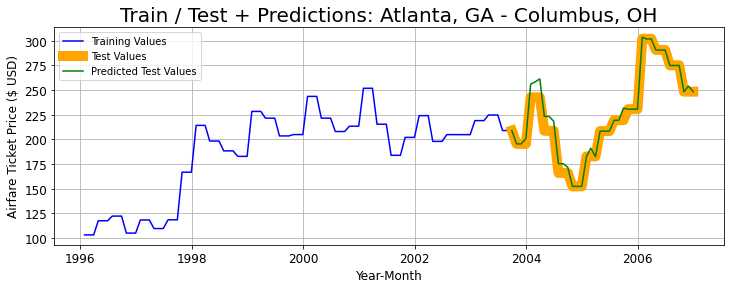

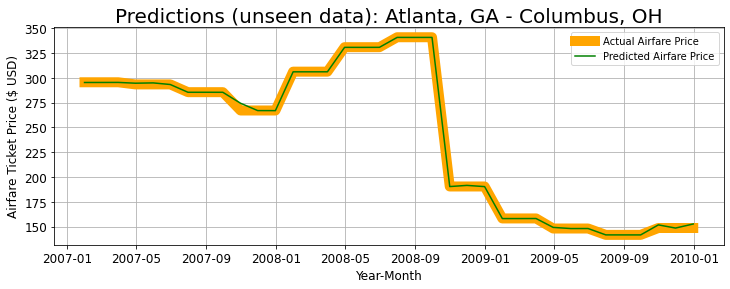

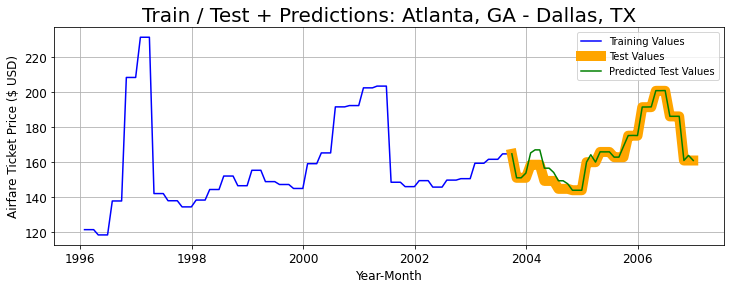

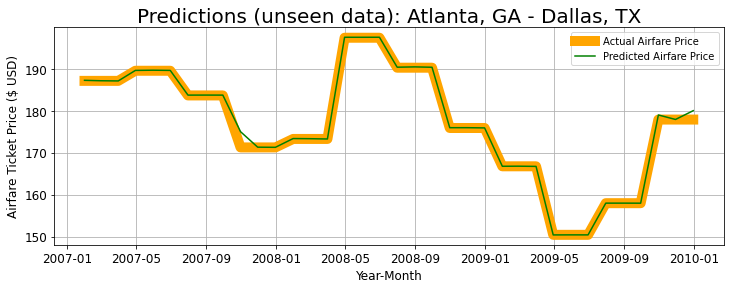

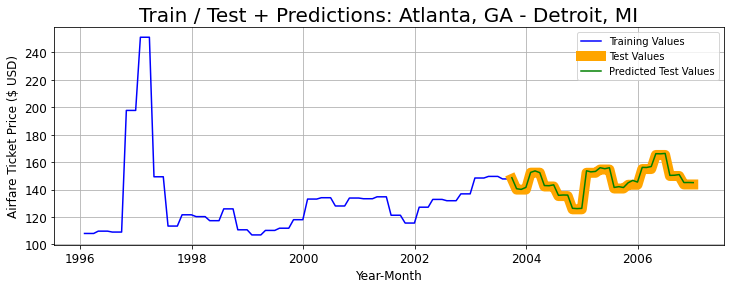

...

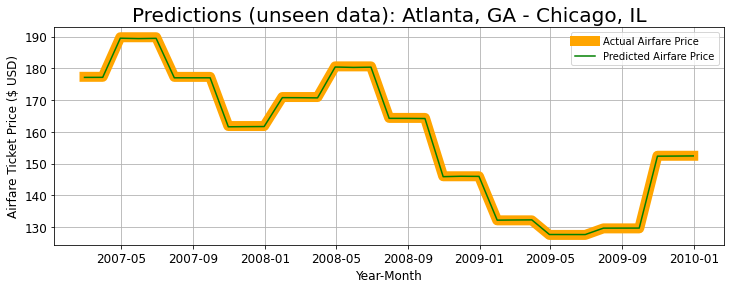

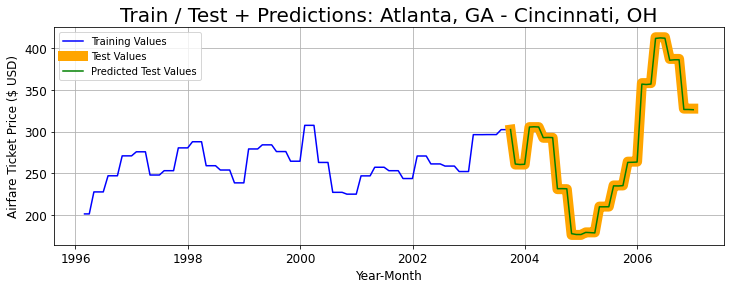

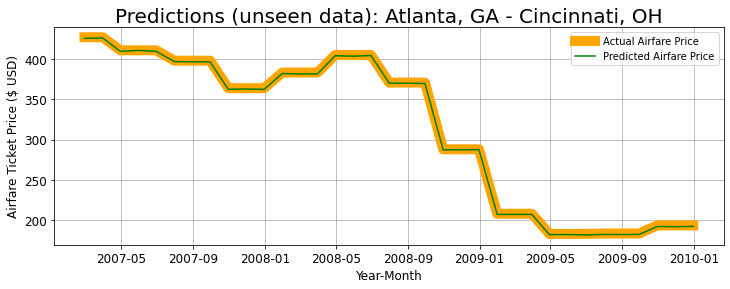

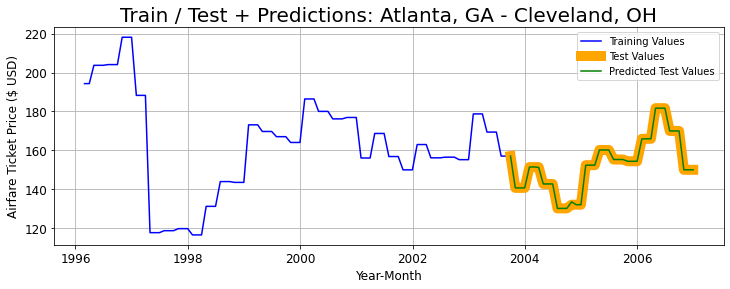

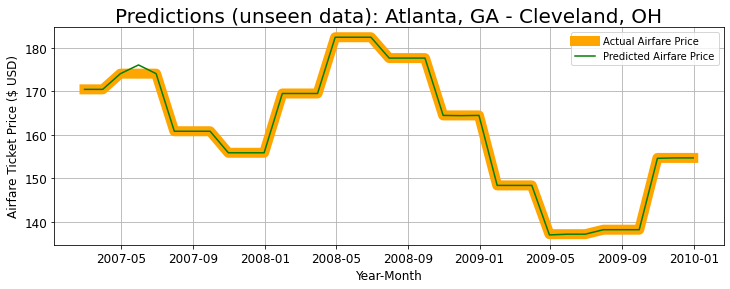

In [488]:
results_df = pd.DataFrame()
for route in train.route.unique(): # add this '[0:1]' to end of statement to see only one route
    model, dataframe = model_func(train, unseen, itinerary=route)
    results_df = pd.concat([results_df, dataframe])

In [489]:
ols_results = results_df.copy()

In [475]:
for i in ols_results.columns[1:]:
    ols_results[i] = ols_results[i].apply(lambda x: round(x, 2))

ols_results.head()

,route,base_r2,train_r2,test_r2,unseen_r2,base_rmse,train_rmse,test_rmse,unseen_rmse
0,"Atlanta, GA - Columbus, OH",0.000000e+00,0.999962,0.976911,0.999572,43.920950,0.268043,6.673816,1.546777
0,"Atlanta, GA - Dallas, TX",1.110223e-16,1.000000,0.962240,0.996862,17.111730,0.017143,3.325153,0.743976
0,"Atlanta, GA - Detroit, MI",-2.220446e-16,0.999842,0.985649,0.982761,9.642247,0.356119,1.155091,1.037787
0,"Atlanta, GA - Hartford, CT",2.220446e-16,0.999932,0.999872,0.999892,46.213603,0.389669,0.522444,0.339498
0,"Atlanta, GA - Houston, TX",1.110223e-16,0.999993,0.999953,0.999945,17.513918,0.103813,0.120084,0.070058


In [476]:
ols_results.describe()

,base_r2,train_r2,test_r2,unseen_r2,base_rmse,train_rmse,test_rmse,unseen_rmse
count,3.750000e+02,375.000000,375.000000,375.000000,375.000000,3.750000e+02,3.750000e+02,3.750000e+02
mean,-1.154632e-17,0.987888,0.638501,0.695445,17.759035,5.882066e-01,1.441646e+00,1.872379e+00
std,1.072389e-16,0.071913,5.733220,2.370100,12.199136,1.707842e+00,5.575670e+00,7.805169e+00
min,-4.440892e-16,0.052725,-109.756589,-26.740658,2.352494,5.015767e-12,7.982302e-12,1.530331e-11
25%,0.000000e+00,0.999515,0.995016,0.991477,9.544366,3.050767e-03,6.236859e-02,1.026653e-01
50%,0.000000e+00,0.999981,0.999629,0.999119,14.675491,9.662574e-02,3.085419e-01,3.999790e-01
75%,0.000000e+00,1.000000,0.999986,0.999937,22.066617,4.594632e-01,1.084869e+00,1.136306e+00
max,2.220446e-16,1.000000,1.000000,1.000000,77.635039,1.710228e+01,8.041525e+01,1.226788e+02


Can R Squared be negative?
Note that it is possible to get a negative R-square for equations that do not contain a constant term. Because R-square is defined as the proportion of variance explained by the fit, if the fit is actually worse than just fitting a horizontal line then R-square is negative.